#**DeciSense Final Project SC**


**Topic** : Object Detection and Instance Segmentation

**Judul** : Optimizing Sustainability through
Corrosion Detection in Construction (OSC)

**Result**:

* Precision: 82.1%
* Recall: 62.4%
* mAP50: 70.6%
* mAP95: 0.459

# Setup


In [1]:
# Install all dependencies

!git clone https://github.com/ultralytics/yolov5.git # clone repo yolo from ultralytics
%cd yolov5
%pip install -r requirements.txt # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)


Setup complete ✅ (8 CPUs, 51.0 GB RAM, 26.9/166.8 GB disk)


# Load Dataset

In [2]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="JRslRiVT996C9RyM4AOU")
project = rf.workspace("cawilcorrosionsegmentation").project("instance-corrosion")
dataset = project.version(2).download("yolov5")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.5/68.5 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 14.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 25.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 37.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.9 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.1.78
    Uninstalling opencv-python-headless-4.8.1.78:
      Successfully uninstal

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to instance-corrosion-2 in yolov5pytorch:: 100%|██████████| 4824/4824 [00:00<00:00, 4841.92it/s]


# Model

```
dataset
├── train
│   ├── images
│   │   ├── IMG_123.jpg
│   └── labels
│       ├── IMG_123.txt
├── valid
│   ├── images
│   │   ├── IMG_456.jpg
│   └── labels
│       ├── IMG_456.txt
├── test
│   ├── images
│   │   ├── IMG_789.jpg
│   └── labels
│       ├── IMG_789.txt
├── data.yaml
├── README.roboflow.txt
```

## Define Custom Model Architecture
Here, we use `YOLOv5m-seg` as Base Model

In [ ]:
# Base Model
%cat /content/yolov5/models/segment/yolov5m-seg.yaml

# YOLOv5 🚀 by Ultralytics, AGPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]

In [ ]:
%%writefile /content/yolov5/models/segment/yolov5-seg-custom.yaml

# Parameters
nc: 1  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3TR, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Segment, [nc, anchors, 32, 256]],  # Detect(P3, P4, P5)
  ]

Overwriting /content/yolov5/models/segment/yolov5-seg-custom.yaml


## Train Custom Model YOLOv5 + Transformer + LayerNormalization

- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs.
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/file/d/1HCN1fFwwT_t5fmfMyKqE8jqG9vOUy8my/view?usp=sharing))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
!python segment/train.py --img 640 --batch 8 --epochs 300 --data {dataset.location}/data.yaml --cfg ./models/segment/yolov5-seg-custom.yaml --weights yolov5m-seg.pt --name model_decisense_result --cache

2023-11-28 09:14:11.779703: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-11-28 09:14:11.779773: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-11-28 09:14:11.779804: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
segment/train: weights=yolov5m-seg.pt, cfg=./models/segment/yolov5-seg-custom.yaml, data=/content/yolov5/instance-corrosion-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, m

Above we see training plots for our custom trained model. This plot along with other detailed results and sample predictions are all automatically generated and stored in the `runs` folder. See `runs/train-seg/exp`.

## Validate Model


In [ ]:
!python segment/val.py --weights best.pt --data {dataset.location}/data.yaml --img 640

segment/val: data=/content/yolov5/instance-corrosion-2/data.yaml, weights=['best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val-seg, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
YOLOv5-seg-custom summary: 232 layers, 21509894 parameters, 0 gradients, 68.8 GFLOPs
val: Scanning /content/yolov5/instance-corrosion-2/valid/labels... 202 images, 0 backgrounds, 0 corrupt: 100% 202/202 [00:00<00:00, 4798.92it/s]
val: New cache created: /content/yolov5/instance-corrosion-2/valid/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 7/7 [00:08<00:00,  1.23s/it]
                   all     

In [ ]:
!python segment/val.py --weights runs/train-seg/model_decisense_result8/weights/best.pt --data {dataset.location}/data.yaml --img 640

segment/val: data=/content/yolov5/instance-corrosion-2/data.yaml, weights=['runs/train-seg/model_decisense_result8/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val-seg, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
YOLOv5-seg-custom summary: 232 layers, 21509894 parameters, 0 gradients, 68.8 GFLOPs
val: Scanning /content/yolov5/instance-corrosion-2/valid/labels.cache... 202 images, 0 backgrounds, 0 corrupt: 100% 202/202 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 7/7 [00:07<00:00,  1.08s/it]
                   all        202        672      0.746      0.6

GROUND TRUTH TRAINING DATA:


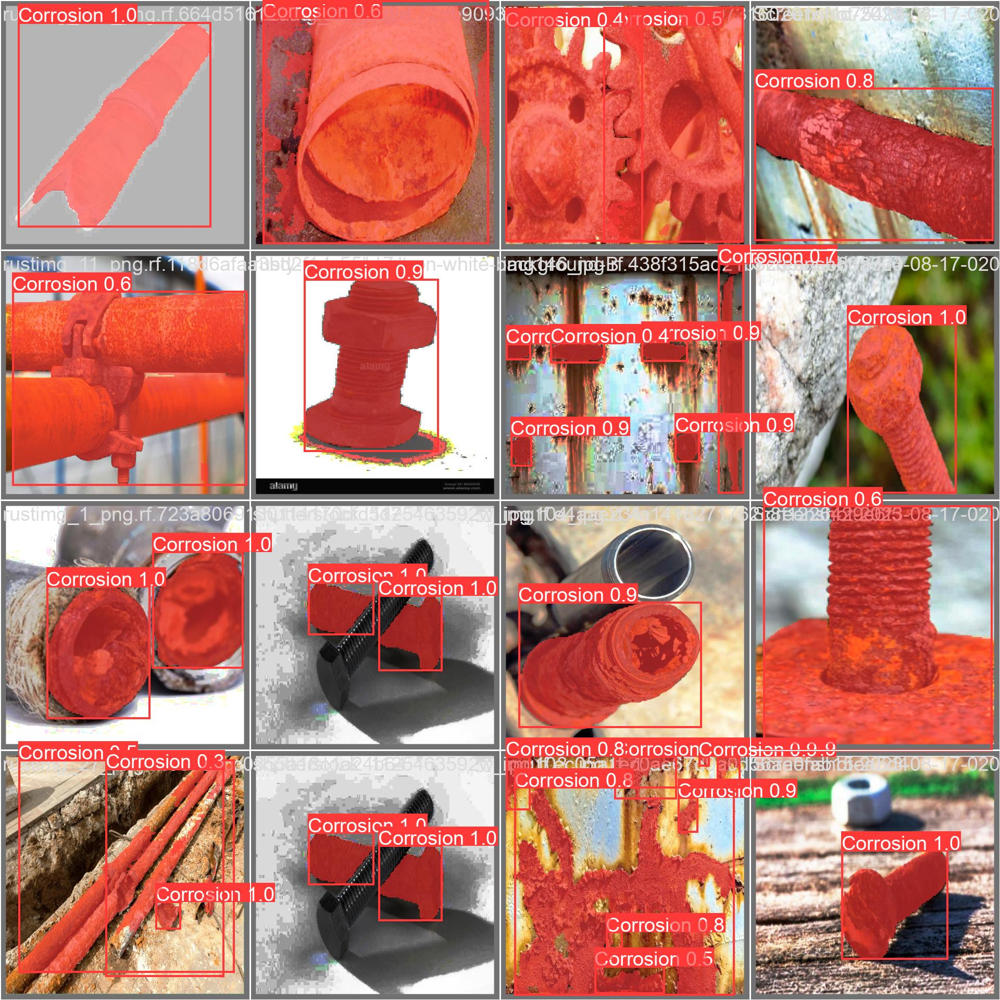

In [ ]:
from IPython.display import Image, clear_output  # to display images

# first, display our ground truth data

print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train-seg/model_decisense_result/val_batch1_pred.jpg', width=900)

## Infer With Custom Model YoloV5

In [3]:
!python segment/predict.py --weights best.pt --img 640 --conf 0.5 --source /content/yolov5/test/

segment/predict: weights=['best.pt'], source=/content/yolov5/test/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/predict-seg, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1, retina_masks=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
YOLOv5-seg-custom summary: 232 layers, 21509894 parameters, 0 gradients, 68.8 GFLOPs
image 1/10 /content/yolov5/test/10tes.jpg: 640x640 3 Corrosions, 12.4ms
image 2/10 /content/yolov5/test/1tes.jpg: 640x640 1 Corrosion, 13.1ms
image 3/10 /content/yolov5/test/2tes.jpg: 640x640 (no detections), 12.9ms
image 4/10 /content/yolov5/test/3tes.jpg: 640x640 1 Corrosion, 12.4ms
image 5/10 /content/yol

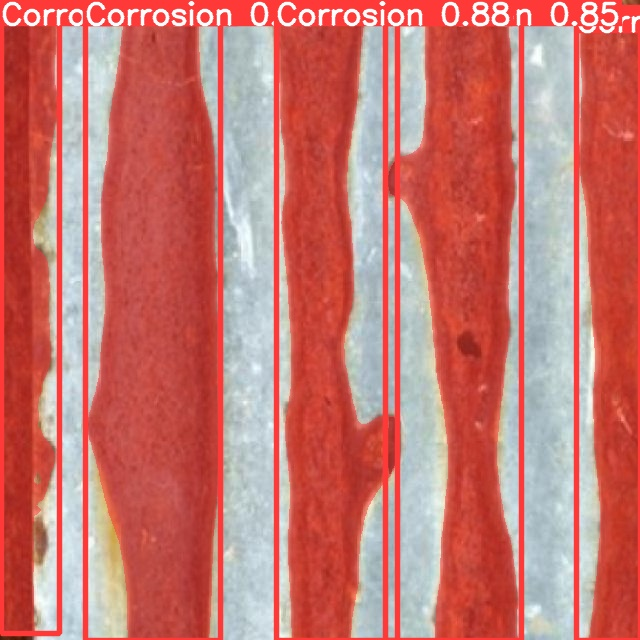

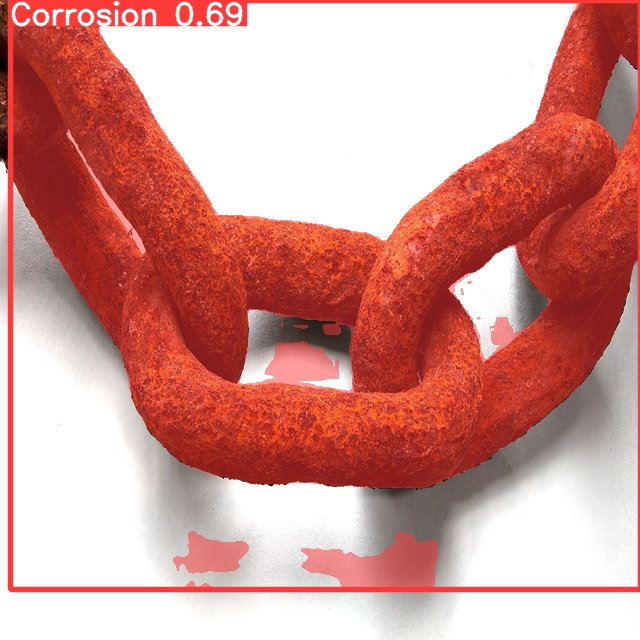

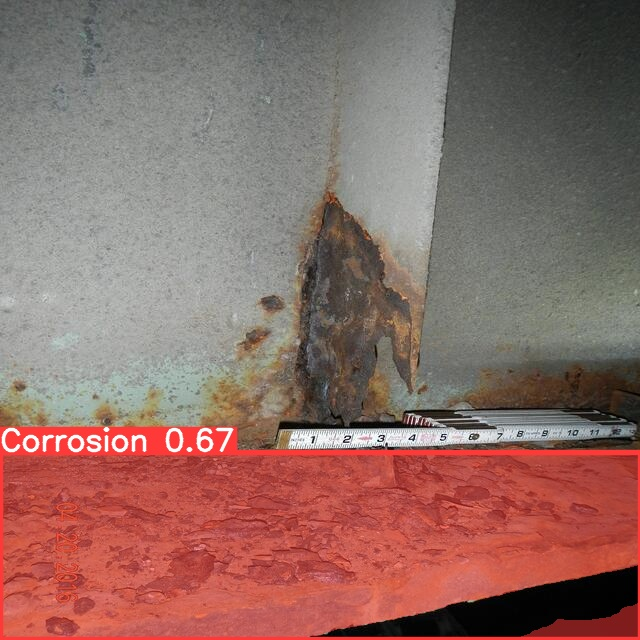

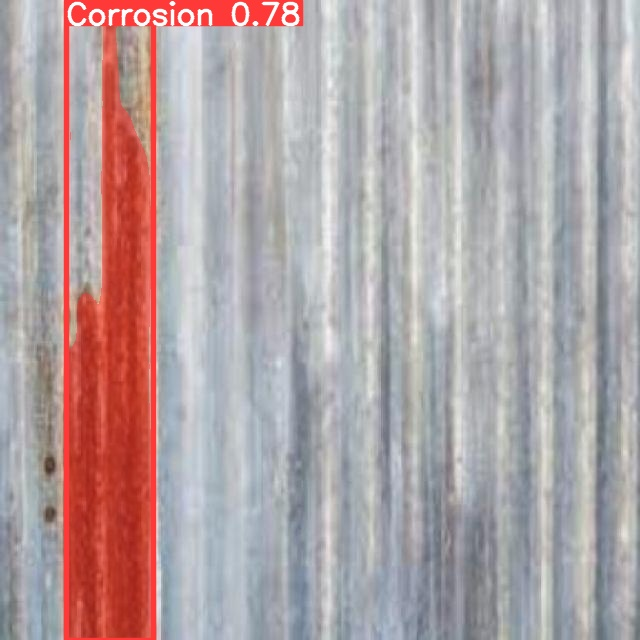

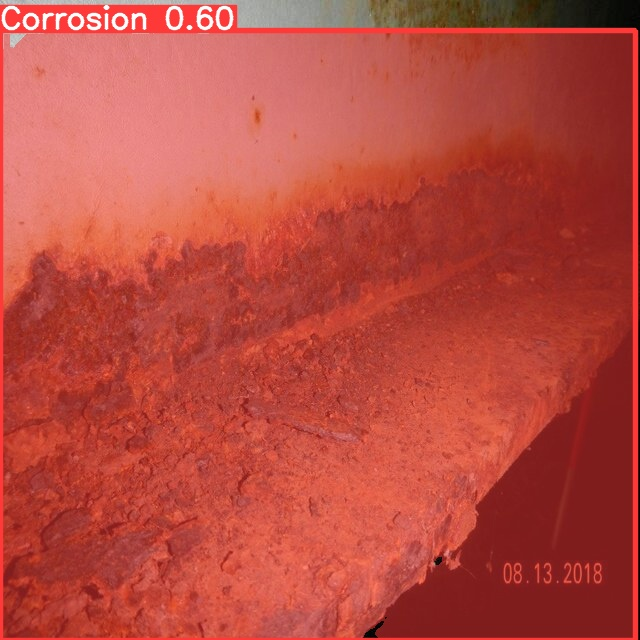

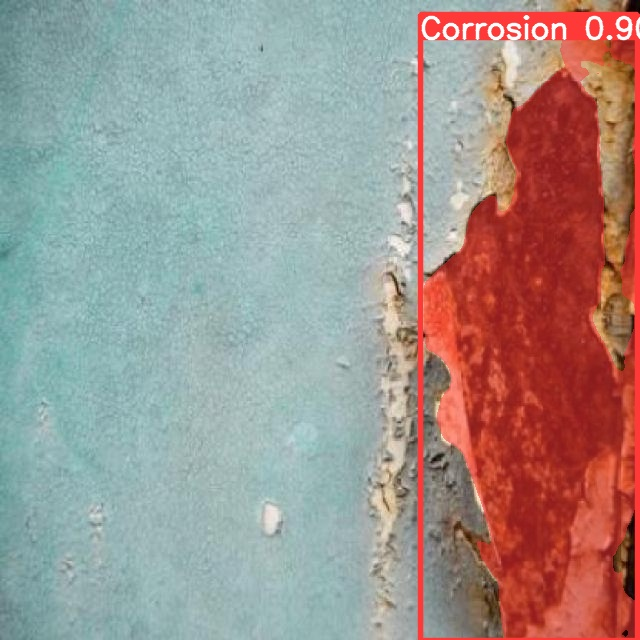

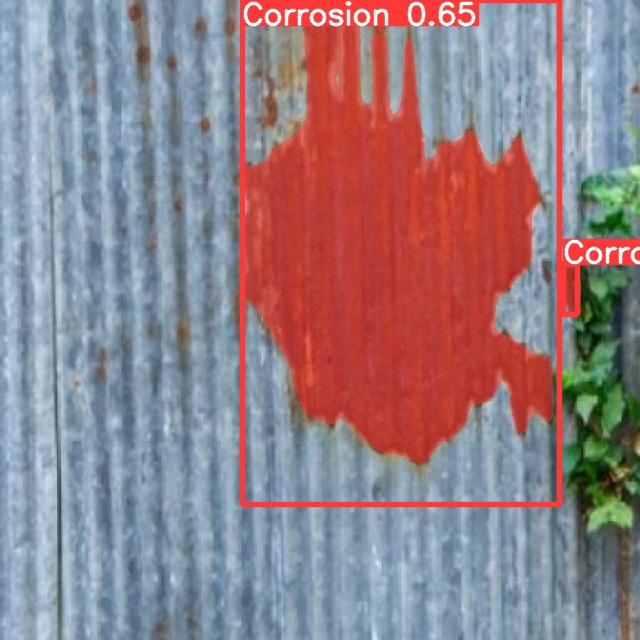

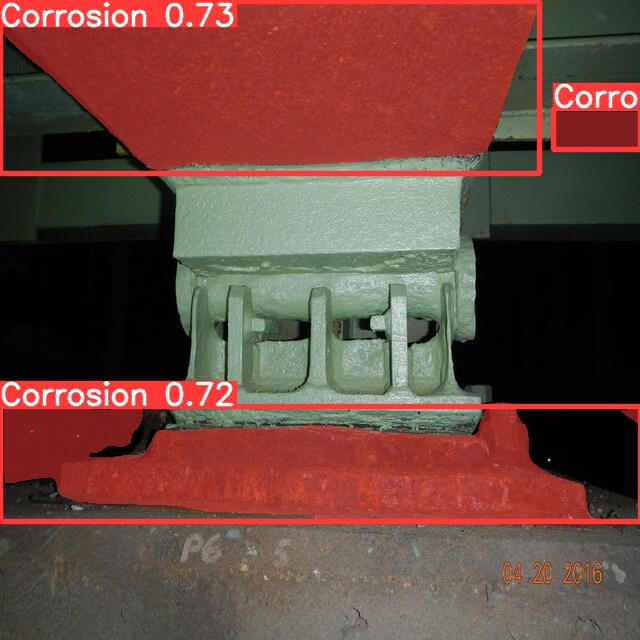

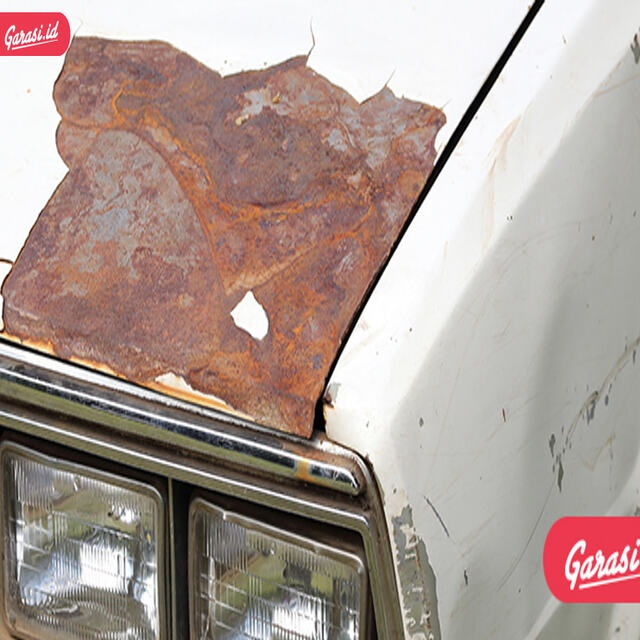

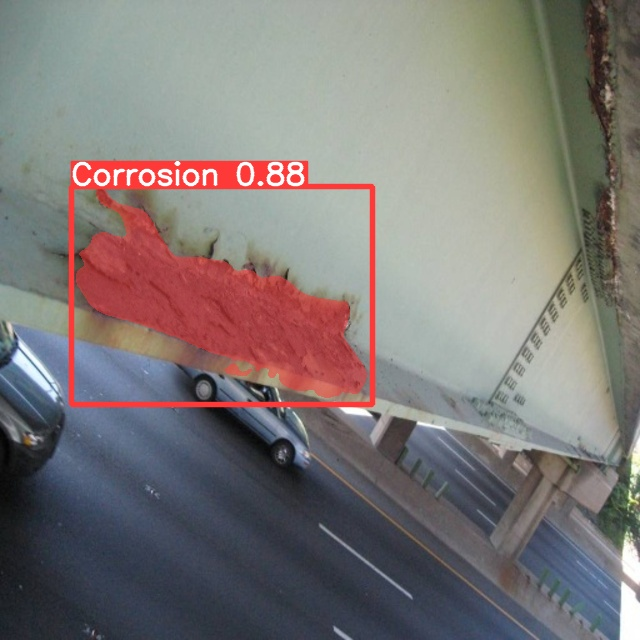

In [4]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/predict-seg/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))

In [ ]:
!python segment/predict.py --weights best.pt --img 640 --conf 0.4 --source /content/yolov5/test/

segment/predict: weights=['best.pt'], source=/content/yolov5/test/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/predict-seg, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1, retina_masks=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
YOLOv5-seg-custom summary: 232 layers, 21509894 parameters, 0 gradients, 68.8 GFLOPs
image 1/8 /content/yolov5/test/000381_jpg.rf.c66bc4bbad91e52c7d7b4fb82545017a.jpg: 640x640 1 Corrosion, 12.9ms
image 2/8 /content/yolov5/test/372.jpeg: 640x640 1 Corrosion, 14.5ms
image 3/8 /content/yolov5/test/CS6_jpg.rf.9ebc0bc3d0432cc200e9b6feefea94c1.jpg: 640x640 1 Corrosion, 13.6ms
image 4/8 /content/yo

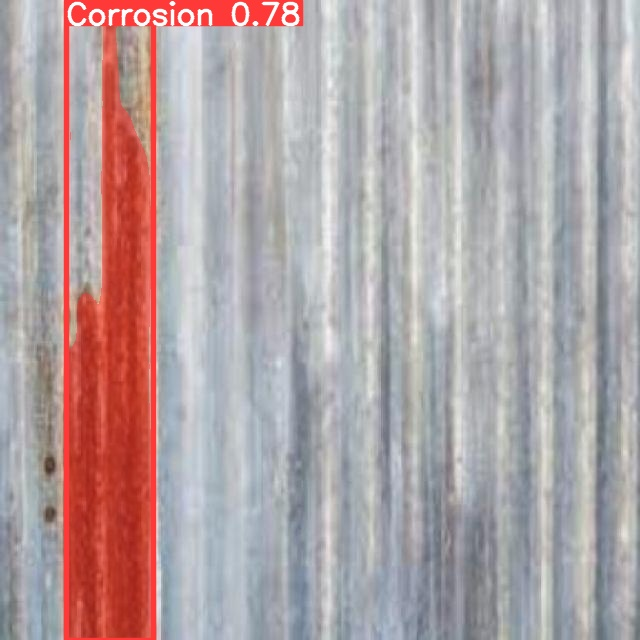

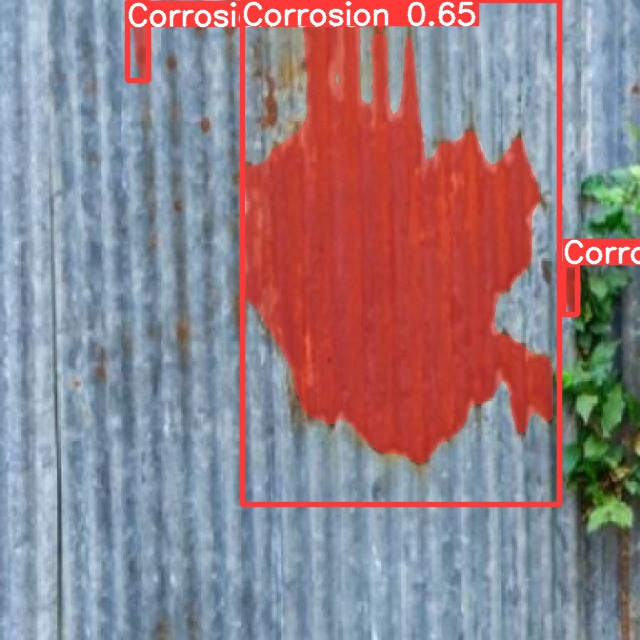

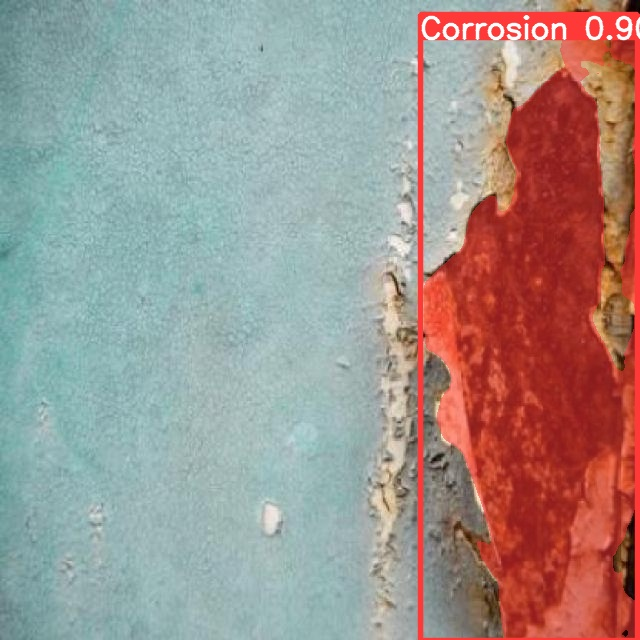

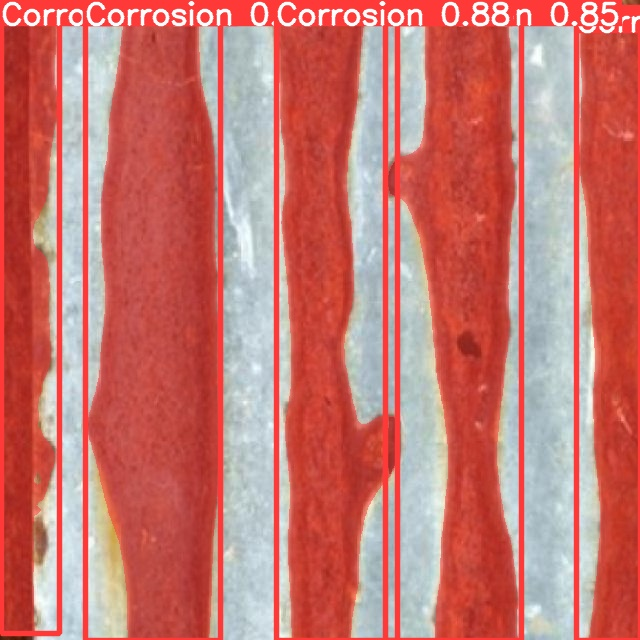

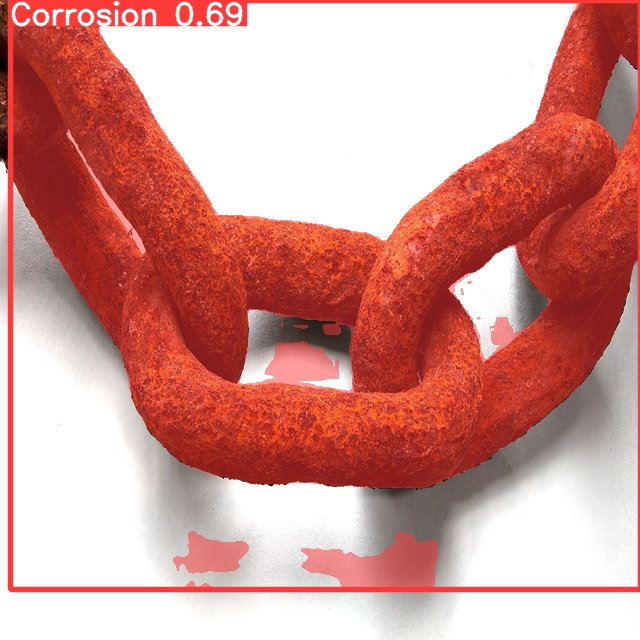

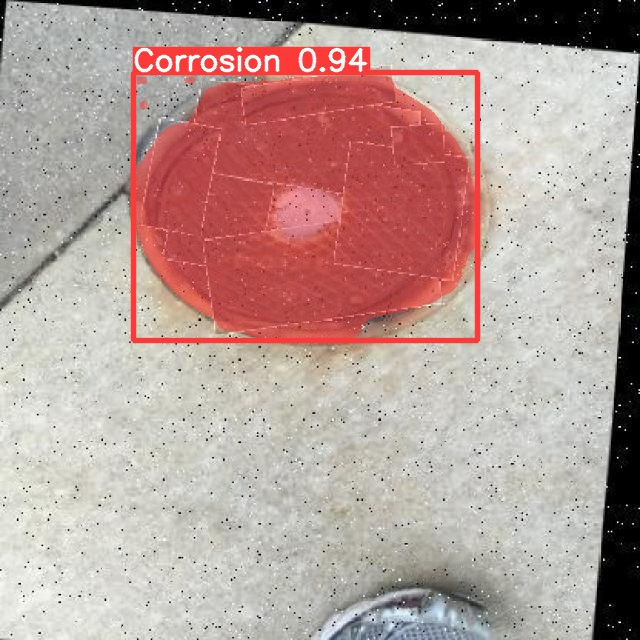

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/predict-seg/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))

In [ ]:
!python segment/predict.py --weights runs/train-seg/model_decisense_result2/weights/best.pt --img 640 --conf 0.4 --source /content/yolov5/instance-corrosion-2/test/images

segment/predict: weights=['runs/train-seg/model_decisense_result/weights/best.pt'], source=/content/yolov5/instance-corrosion-2/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.35, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/predict-seg, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1, retina_masks=False
YOLOv5 🚀 v7.0-245-g3d8f004 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
YOLOv5m-seg summary: 220 layers, 21652358 parameters, 0 gradients, 69.8 GFLOPs
image 1/98 /content/yolov5/instance-corrosion-2/test/images/000014_jpg.rf.1f84eb1495ba058ce976718483cabb29.jpg: 640x640 1 Corrosion, 8.0ms
image 2/98 /content/yolov5/instance-corrosion-2/test/images/000034_jpg.rf.9fff4913f12a9bd227d4dce5784c

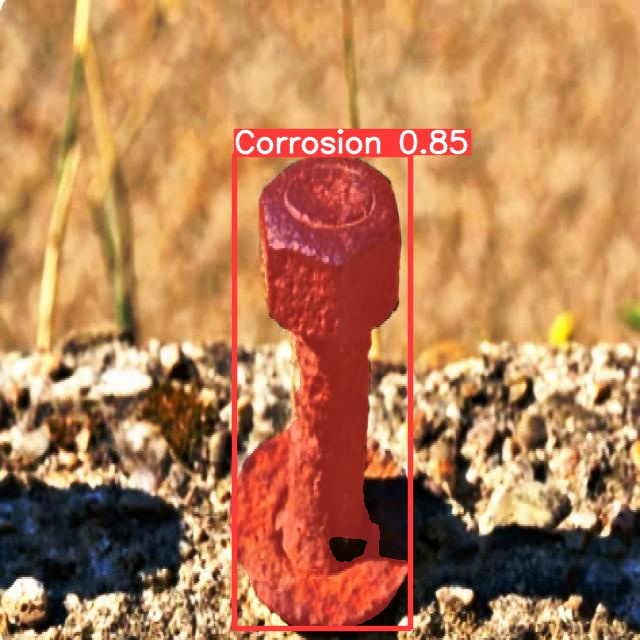

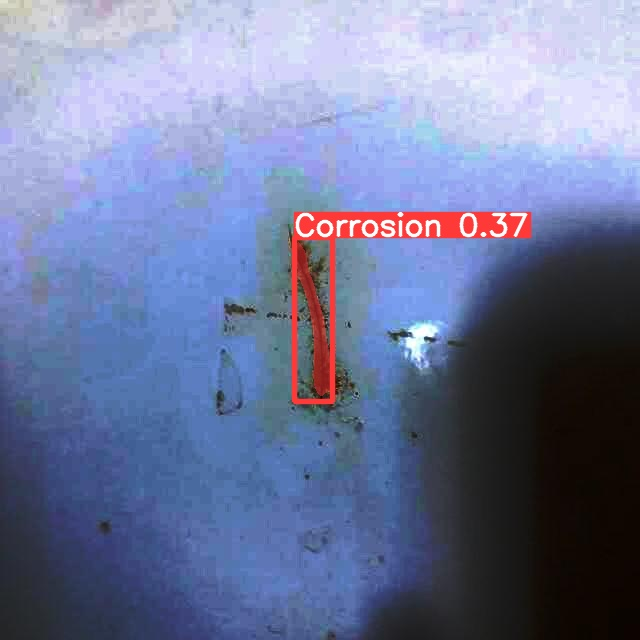

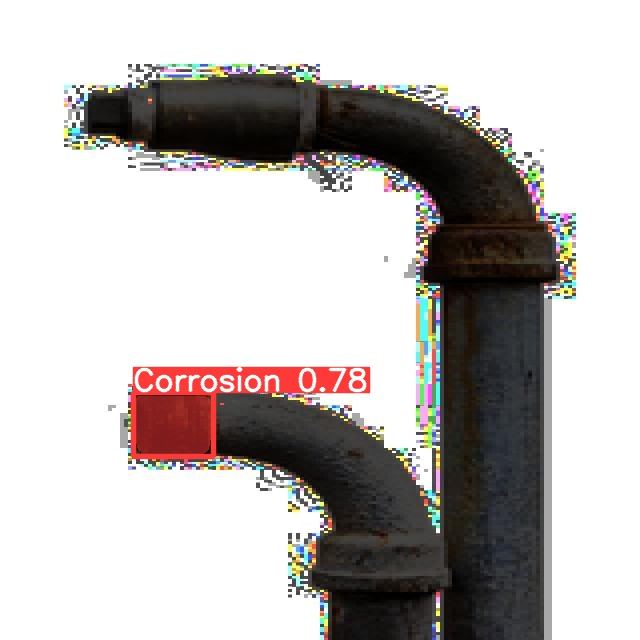

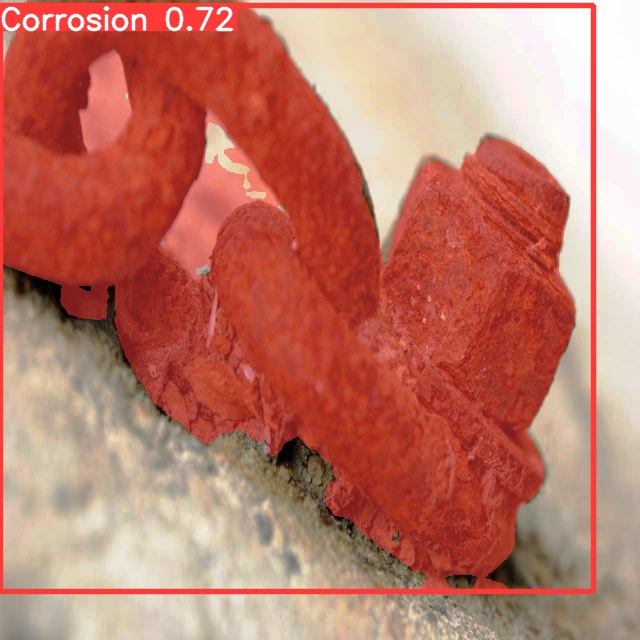

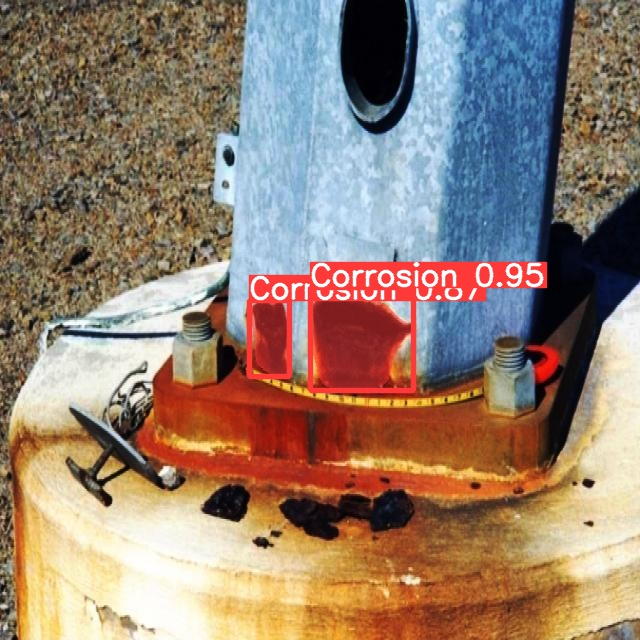

...

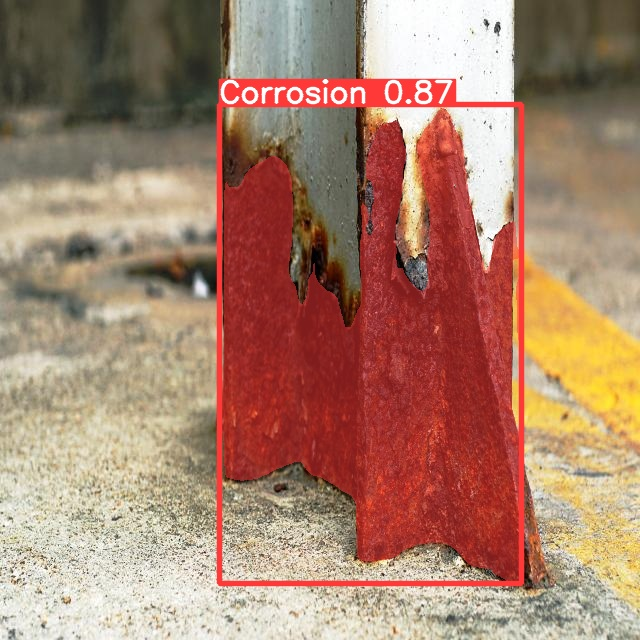

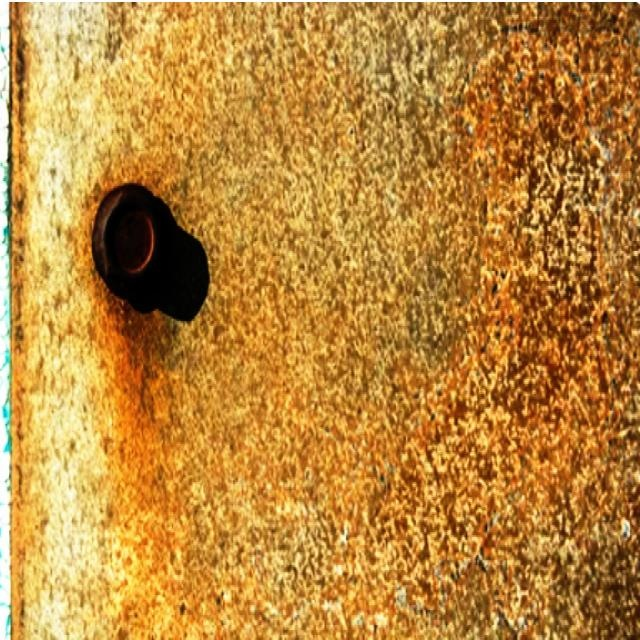

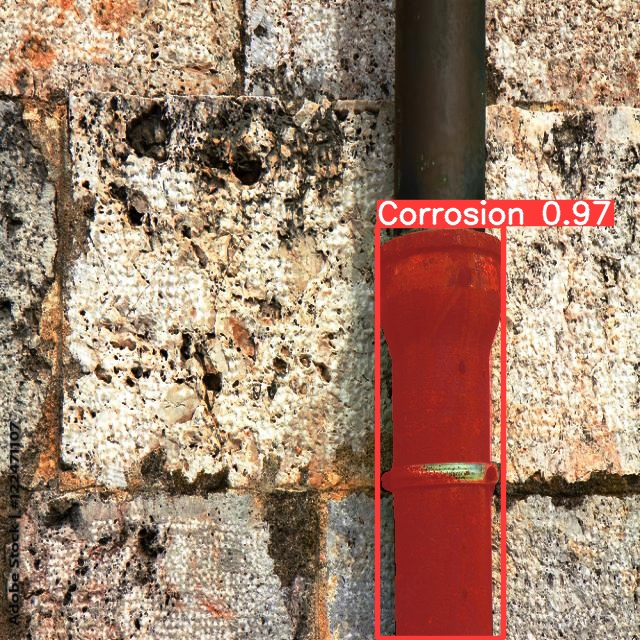

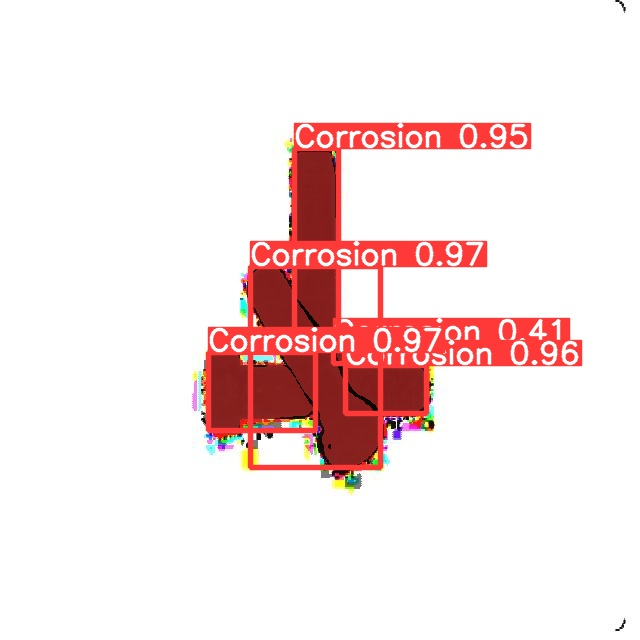

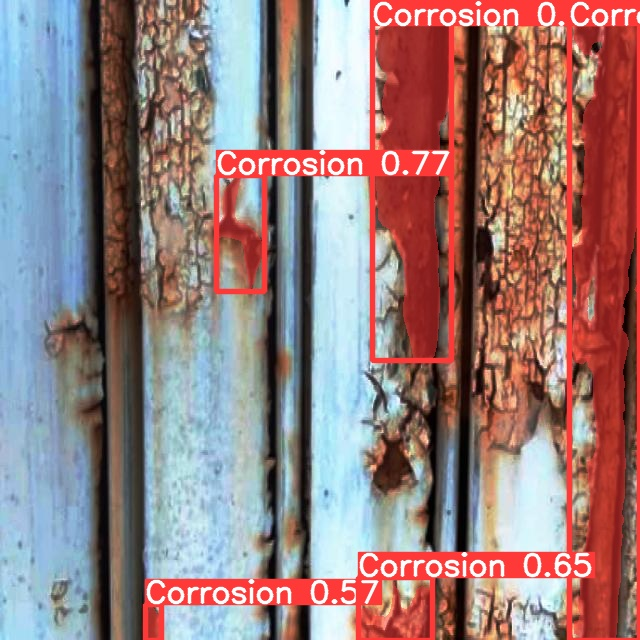

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/predict-seg/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))

# Save Model or Export Trained Weights

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cp /content/yolov5/runs/train-seg/model_decisense_result/weights/best.pt /content/gdrive/MyDrive/Dataset